In [123]:
import librosa
import librosa.display
import numpy as np
import pandas as pd
import math
import scipy.stats
import IPython.display as ipd
import matplotlib.pyplot as plt

In [18]:
file_dir = "../resources/boneym_daddycool.wav" 

In [103]:
ipd.Audio(file_dir)

In [91]:
y, sr = librosa.load(file_dir, duration = 30)
#y_30, sr_30 = librosa.load(file_dir, duration = 30)
y_full, sr_full = librosa.load(file_dir)

# TEMPO

In [ ]:
onset_env = librosa.onset.onset_strength(y, sr=sr)
tempo = librosa.beat.tempo(onset_envelope=onset_env, sr=sr)
tempo

prior = scipy.stats.uniform(30, 300)  # uniform over 30-300 BPM
utempo = librosa.beat.tempo(onset_envelope=onset_env, sr=sr, prior=prior)

dtempo = librosa.beat.tempo(onset_envelope=onset_env, sr=sr,
                            aggregate=None)

# Convert to scalar
tempo = tempo.item()
utempo = utempo.item()
# Compute 2-second windowed autocorrelation
hop_length = 512
ac = librosa.autocorrelate(onset_env, 2 * sr // hop_length)
freqs = librosa.tempo_frequencies(len(ac), sr=sr,
                                  hop_length=hop_length)
# Plot on a BPM axis.  We skip the first (0-lag) bin.
fig, ax = plt.subplots()
ax.semilogx(freqs[1:], librosa.util.normalize(ac)[1:],
             label='Onset autocorrelation', basex=2)
ax.axvline(tempo, 0, 1, alpha=0.75, linestyle='--', color='r',
            label='Tempo (default prior): {:.2f} BPM'.format(tempo))
ax.axvline(utempo, 0, 1, alpha=0.75, linestyle=':', color='g',
            label='Tempo (uniform prior): {:.2f} BPM'.format(utempo))
ax.set(xlabel='Tempo (BPM)', title='Static tempo estimation')
ax.grid(True)
ax.legend()

# SELECT VIRTUAL COMPAS TIME

In [161]:
beat_num = 4
bpm = tempo
srate = sr_full

In [172]:
song_duration= librosa.get_duration(y=y_full, sr=sr_full)

vcompas_time = beat_num * 60 / bpm
vcompas_num  = song_duration / vcompas_time)

compas_sample_num = vcompas_time * srate
song_sample_num = compas_sample_num * vcompas_num

In [173]:
len(y_full)

4598808

In [176]:
y_full[0:10]

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0.], dtype=float32)

# LOOP THROGH SONG VIRTUAL COMPASES

In [196]:
vcompas_data = {}
for vcompas_i in range(0,math.floor(vcompas_num)): 
    
    start = math.floor(compas_sample_num * vcompas_i)
    end = math.floor(compas_sample_num * (vcompas_i + 1))
    selected_samples = y_full[start:end]
    #y, sr = librosa.load(file_dir,offset = start, duration = end, sr = 22050)
    vcompas_data[vcompas_i] = ([selected_samples],vcompas_time * vcompas_i)
    print(len(selected_samples))

43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008
43008


In [197]:
df = pd.DataFrame.from_dict(vcompas_data, orient = 'index', columns = ['wform','times'])

In [201]:
df.head(11)

,wform,times
0,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.000000
1,"[[-0.07071532, -0.10625816, -0.06316459, -0.00...",1.950476
2,"[[-0.0063526593, 0.063901305, 0.02116755, -0.1...",3.900952
3,"[[0.006363783, 0.003857712, 0.011776242, 0.016...",5.851429
4,"[[-0.08140365, -0.0794335, -0.07543977, -0.067...",7.801905
5,"[[-0.060178142, -0.050000094, -0.042488743, -0...",9.752381
6,"[[-0.09681778, -0.09938283, -0.102067836, -0.1...",11.702857
7,"[[-0.024726933, -0.035673246, -0.046949256, -0...",13.653333
8,"[[0.07991629, 0.06590936, 0.04539425, 0.021452...",15.603810
9,"[[-0.17159815, -0.17995827, -0.15978432, -0.17...",17.554286


# WAVEFORMS

[Text(0.5, 1.0, 'Harmonic + Percussive')]

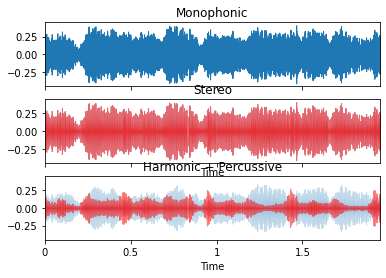

In [191]:
fig, ax = plt.subplots(nrows=3, sharex=True, sharey=True)

librosa.display.waveplot(df.wform[10], sr=sr, ax=ax[0])
ax[0].set(title='Monophonic')
ax[0].label_outer()

librosa.display.waveplot(df.wform[10], sr=sr, alpha=0.25, ax=ax[1])
librosa.display.waveplot(df.wform[10], sr=sr, color='r', alpha=0.5, ax=ax[1])
ax[1].set(title='Stereo')

y_harm, y_perc = librosa.effects.hpss(df.wform[10])
librosa.display.waveplot(y_harm, sr=sr, alpha=0.25, ax=ax[2])
librosa.display.waveplot(y_perc, sr=sr, color='r', alpha=0.5, ax=ax[2])
ax[2].set(title='Harmonic + Percussive')

In [56]:
y, sr = librosa.load(file_dir, duration=5)
S = np.abs(librosa.stft(y))
comps, acts = librosa.decompose.decompose(S, n_components=8)

[Text(0, 0.5, 'Components'), Text(0.5, 1.0, 'Activations')]

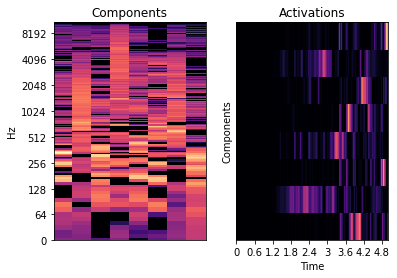

In [101]:
fig, ax = plt.subplots(nrows=1, ncols=2)
librosa.display.specshow(librosa.amplitude_to_db(comps,
                                                 ref=np.max),
                         y_axis='log', ax=ax[0])
ax[0].set(title='Components')
librosa.display.specshow(acts, x_axis='time', ax=ax[1])
ax[1].set(ylabel='Components', title='Activations')

C:\Users\urgpa\anaconda3\lib\site-packages\librosa\display.py:974: MatplotlibDeprecationWarning: The 'basey' parameter of __init__() has been renamed 'base' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)
C:\Users\urgpa\anaconda3\lib\site-packages\librosa\display.py:974: MatplotlibDeprecationWarning: The 'linthreshy' parameter of __init__() has been renamed 'linthresh' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)
C:\Users\urgpa\anaconda3\lib\site-packages\librosa\display.py:974: MatplotlibDeprecationWarning: The 'linscaley' parameter of __init__() has been renamed 'linscale' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)


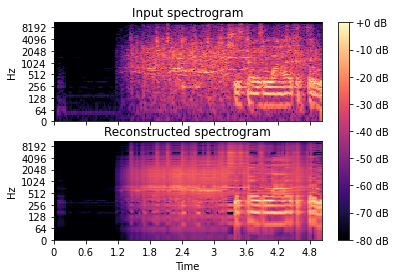

In [100]:
fig, ax = plt.subplots(nrows=2, sharex=True, sharey=True)
librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Input spectrogram')
ax[0].label_outer()
S_approx = comps.dot(acts)
img = librosa.display.specshow(librosa.amplitude_to_db(S_approx,
                                                 ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[1])
ax[1].set(title='Reconstructed spectrogram')
fig.colorbar(img, ax=ax, format="%+2.f dB")

<ipython-input-122-e76337b963de>:22: MatplotlibDeprecationWarning: The 'basex' parameter of __init__() has been renamed 'base' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  ax.semilogx(freqs[1:], librosa.util.normalize(ac)[1:],


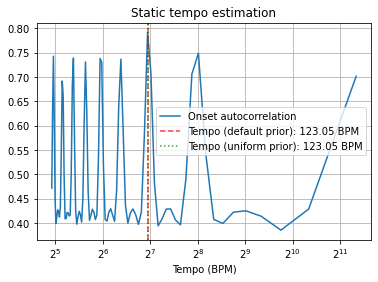

In [122]:
y, sr = librosa.load(file_dir)
onset_env = librosa.onset.onset_strength(y, sr=sr)
tempo = librosa.beat.tempo(onset_envelope=onset_env, sr=sr)
tempo

prior = scipy.stats.uniform(30, 300)  # uniform over 30-300 BPM
utempo = librosa.beat.tempo(onset_envelope=onset_env, sr=sr, prior=prior)

dtempo = librosa.beat.tempo(onset_envelope=onset_env, sr=sr,
                            aggregate=None)

# Convert to scalar
tempo = tempo.item()
utempo = utempo.item()
# Compute 2-second windowed autocorrelation
hop_length = 512
ac = librosa.autocorrelate(onset_env, 2 * sr // hop_length)
freqs = librosa.tempo_frequencies(len(ac), sr=sr,
                                  hop_length=hop_length)
# Plot on a BPM axis.  We skip the first (0-lag) bin.
fig, ax = plt.subplots()
ax.semilogx(freqs[1:], librosa.util.normalize(ac)[1:],
             label='Onset autocorrelation', basex=2)
ax.axvline(tempo, 0, 1, alpha=0.75, linestyle='--', color='r',
            label='Tempo (default prior): {:.2f} BPM'.format(tempo))
ax.axvline(utempo, 0, 1, alpha=0.75, linestyle=':', color='g',
            label='Tempo (uniform prior): {:.2f} BPM'.format(utempo))
ax.set(xlabel='Tempo (BPM)', title='Static tempo estimation')
ax.grid(True)
ax.legend()